h_values: [0.   0.25 1.   0.25 0.  ]


C:\Users\adop\AppData\Local\Temp\ipykernel_11832\2953475679.py:26: MatplotlibDeprecationWarning: The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.
  plt.stem(y[:100], use_line_collection=True, linefmt='r-')
C:\Users\adop\AppData\Local\Temp\ipykernel_11832\2953475679.py:27: MatplotlibDeprecationWarning: The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.
  plt.stem(x[:100], use_line_collection=True, linefmt='b-')


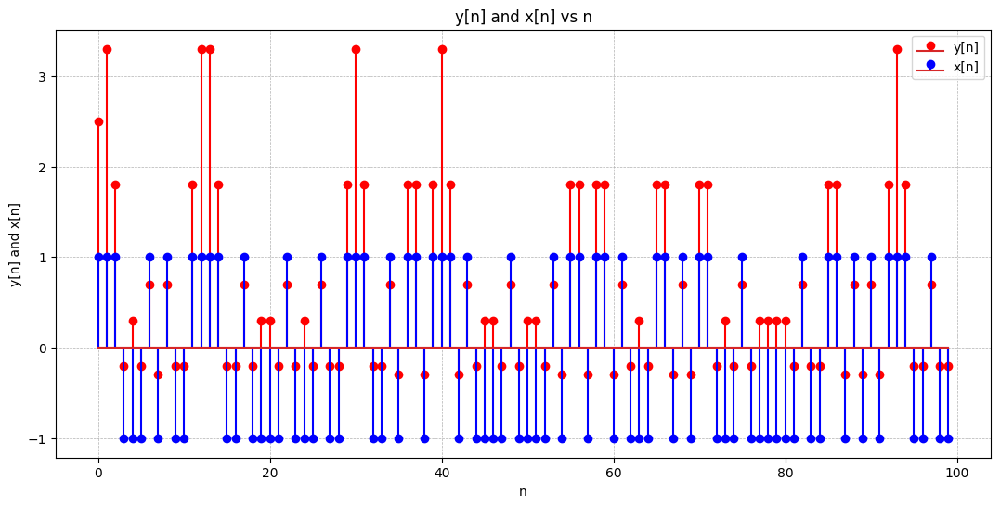

In [34]:
import numpy as np
import matplotlib.pyplot as plt

L=50000
a=0.8
x = np.random.choice([-1, 1], L)

def h(k):
    if 1 <= k <= 3:
        return 0.5 * (1 + np.cos(2 * np.pi * (k - 2) / 3))
    else:
        return 0

# Generate h_values for k = 0 to 4 (assuming 5 total values for convolution)
h_values = np.array([h(k) for k in range(5)])

# Print the impulse response for verification
print("h_values:", h_values)

# Convolve x with h_values
y = np.convolve(x, h_values, mode='same')
y = y + (a*(y**2))

plt.figure(figsize=(13, 6))
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.stem(y[:100], use_line_collection=True, linefmt='r-')
plt.stem(x[:100], use_line_collection=True, linefmt='b-')
plt.xlabel('n')
plt.ylabel('y[n] and x[n]')
plt.title('y[n] and x[n] vs n')
plt.legend(['y[n]', 'x[n]'])
plt.show()


Sample 0:
Net Input: -0.06913214861951143
Output: -0.06902222538983134
Error: -1.0690222253898314
Weight Gradient: [-0.25276276  0.97612305  0.97611975  0.18616623  0.97617223  0.53729021
  0.53727828  0.97616693  0.18618217  0.97615772  0.53727828]
Bias Gradient: -1.0639293312445615
Sample 1:
Net Input: 0.06501944704741655
Output: 0.0649279778647072
Error: -0.9350720221352928
Weight Gradient: [0.85427864 0.85428376 0.16289779 0.85431422 0.47022586 0.47022586
 0.8543141  0.16294298 0.85432216 0.47021542 0.8543141 ]
Bias Gradient: -0.9311300929562562
Sample 2:
Net Input: 0.19238342287995286
Output: 0.19004458351142642
Error: 1.1900445835114264
Weight Gradient: [-1.05239012 -0.20067682 -1.05239287 -0.57925569 -0.57927359 -1.05244945
 -0.20072225 -1.05244374 -0.57926959 -1.0524338  -0.20072225]
Bias Gradient: 1.1470638102620356
Sample 3:
Net Input: 0.12741234766738072
Output: 0.12672732883030186
Error: -0.8732726711696981
Weight Gradient: [0.15031617 0.78833417 0.43388195 0.43391164 0.788

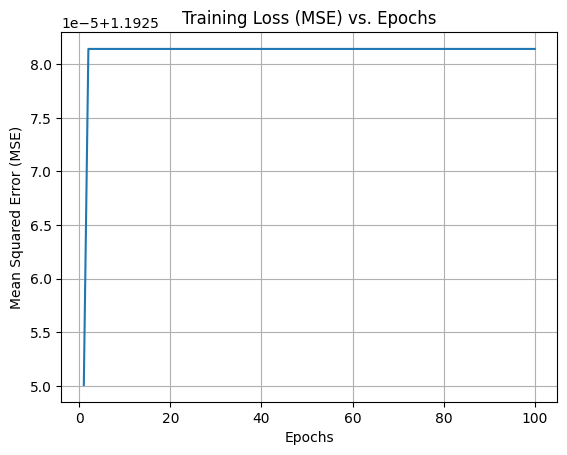

Training completed.


In [13]:
import numpy as np
import matplotlib.pyplot as plt

M = 11  # Number of inputs to the neural network
D = 7  # Delay
epochs = 100 # Number of epochs for training
learning_rate = 0.03

# Prepare data for training the neural network
X = np.array([y[i:i+M] for i in range(L - M - D)])  # Inputs to the network
y_true = x[M+D:L]  # Delayed target symbols

mean_X = np.mean(X, axis=0)  # Compute mean for each feature
std_X = np.std(X, axis=0) + 1e-8  # Compute std deviation for each feature, add small value to avoid division by zero
X_normalized = (X - mean_X) / std_X 


# Initialize weights and biases for the neural network
weights = np.random.randn(M) * 0.02 # Weights
bias = 0 # Initialize bias to zero

# Activation function
def tanh(x):
    return np.tanh(x)

def tanh_derivative(x):
    return 1 - np.tanh(x)**2

# Activation function: ReLU
def relu(x):
    return np.maximum(0, x)

def relu_derivative(x):
    return (x > 0).astype(float)

# Leaky ReLU Activation
def leaky_relu(x, alpha=0.01):
    return np.where(x > 0, x, alpha * x)

def leaky_relu_derivative(x, alpha=0.01):
    return np.where(x > 0, 1, alpha)


# Training loop
losses = []
for epoch in range(epochs):
    total_loss = 0
    for i in range(len(X)):
        # Forward pass
        net_input = np.dot(weights, X_normalized[i]) + bias
        output = tanh(net_input)

        # Compute error
        error = output - y_true[i]

        # Backpropagation
        d_output = error * tanh_derivative(net_input)
        weights_gradient = d_output * X_normalized[i]
        bias_gradient = d_output

        # Update weights and biases using gradient descent
        weights -= learning_rate * weights_gradient
        bias -= learning_rate * bias_gradient

        # Accumulate loss
        total_loss += error**2
        if epoch == 0 and i < 5:
            print(f"Sample {i}:")
            print(f"Net Input: {net_input}")
            print(f"Output: {output}")
            print(f"Error: {error}")
            print(f"Weight Gradient: {weights_gradient}")
            print(f"Bias Gradient: {bias_gradient}")

    # Store mean squared error for the epoch
    mse = total_loss / len(X_normalized)
    losses.append(mse)
    if epoch % 10 == 0:
        print(f"Epoch {epoch+1}/{epochs}, MSE: {mse}")

# Plot MSE vs. Epochs
plt.figure()
plt.plot(range(1, epochs+1), losses)
plt.title('Training Loss (MSE) vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error (MSE)')
plt.grid()
plt.show()
print("Training completed.")

Number of Bit Errors: 6301
Total Bits: 49982
Bit Error Rate (BER): 0.126065


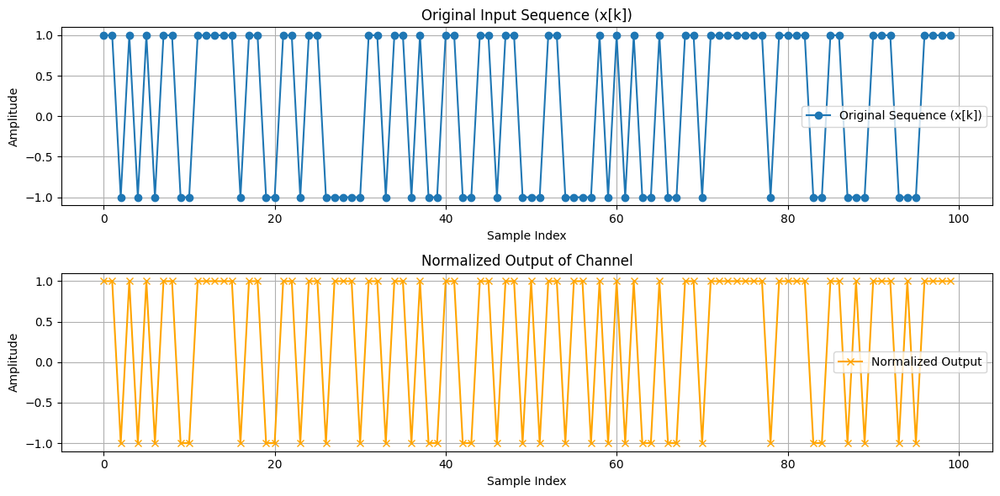

In [4]:
# Align the sequences
original_sequence = x[M+D:L]  # True input sequence after accounting for delay
normalized_output = np.where(y > 0, 1, -1)[M+D:L]  # Normalized output aligned to the original

# Calculate BER
bit_errors = np.sum(original_sequence != normalized_output)  # Count mismatches
total_bits = len(original_sequence)
ber = bit_errors / total_bits

print(f"Number of Bit Errors: {bit_errors}")
print(f"Total Bits: {total_bits}")
print(f"Bit Error Rate (BER): {ber:.6f}")

# Plot original sequence vs normalized output for comparison
plt.figure(figsize=(12, 6))

# Plot the original input sequence x[k]
plt.subplot(2, 1, 1)
plt.plot(original_sequence[:100], label="Original Sequence (x[k])", linestyle="-", marker="o")
plt.title("Original Input Sequence (x[k])")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid()
plt.legend()

# Plot the normalized output
plt.subplot(2, 1, 2)
plt.plot(normalized_output[:100], label="Normalized Output", linestyle="-", marker="x", color="orange")
plt.title("Normalized Output of Channel")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()


In [48]:
def nonlinear_adaptive_equalizer(y, x, M=11, eta=0.075, max_iter=700, delay=7, activation='tanh', init_method='zeros'):
    """
    Nonlinear adaptive equalizer using gradient descent.
    
    Parameters:
    y: Channel output
    x: Original data sequence
    M: Number of taps in the equalizer
    eta: Learning rate
    max_iter: Maximum number of iterations
    delay: Delay to align equalizer output with input
    activation: Nonlinear activation function ('tanh', 'relu', 'leaky_relu')
    
    Returns:
    weights: Final equalizer weights
    e2: Squared error over iterations
    equalized_output: Equalized signal after convergence
    """
    # Initialize weights and error tracking
    if init_method == 'gaussian':
        # Gaussian initialization with mean=0 and variance=0.1
        weights = np.random.normal(0, 0.1, M)
    elif init_method == 'he':
        # He initialization for ReLU-like activations
        weights = np.random.normal(0, np.sqrt(2 / M), M)
    elif init_method == 'xavier':
        # Xavier initialization for tanh-like activations
        weights = np.random.normal(0, np.sqrt(1 / M), M)
    elif init_method == 'zeros':
        weights = np.zeros(M)
    else:
        raise ValueError("Unsupported initialization method. Choose 'gaussian', 'he', or 'xavier'.") # Gaussian random weights
    bias = 0.0 # Initialize weights to zero
    e2 = []  # List to store squared error over iterations
    equalized_output = np.zeros_like(y)  # Initialize equalized output

    # Activation function and its derivative
    if activation == 'tanh':
        act = lambda x: np.tanh(x)
        act_derivative = lambda x: 1 - np.tanh(x)**2
    elif activation == 'relu':
        act = lambda x: np.maximum(0, x)
        act_derivative = lambda x: (x > 0).astype(float)
    elif activation == 'leaky_relu':
        alpha = 0.01
        act = lambda x: np.where(x > 0, x, alpha * x)
        act_derivative = lambda x: np.where(x > 0, 1, alpha)
    else:
        raise ValueError("Unsupported activation function. Choose 'tanh', 'relu', or 'leaky_relu'.")

    # Pad the channel output for M-tap filtering
    y_padded = np.pad(y, (M - 1, 0), mode='constant')

    for iteration in range(max_iter):
        total_error = 0
        for k in range(len(x) - abs(delay) - M + 1):
            # Extract M-tap window and reverse for convolution-like operation
            y_tap = y_padded[k:k + M][::-1]  

            if len(y_tap) != M:
                continue  # Skip invalid windows

            # Nonlinear transformation
            nonlinear_output = act(np.dot(weights, y_tap)) + bias

            # Compute equalizer output
            x_hat = nonlinear_output
            equalized_output[k] = x_hat

            # Compute error (positive or negative delay handled)
            if delay >= 0:
                error = x_hat - x[k + delay]  # Positive delay
            else:
                error = x_hat - x[k - abs(delay)] 

            # Update weights using gradient descent with activation derivative
            delta = error * act_derivative(nonlinear_output)
            weights_gradient = delta * y_tap
            bias_gradient = delta

            weights -= eta * weights_gradient
            bias -= eta * bias_gradient

            # Accumulate squared error
            total_error += error**2
            
            if iteration % 10 == 0:
                print(f"Epoch {iteration+1}/{iteration}, MSE: {mse}")

        # Store mean squared error for the current iteration
        e2.append(total_error / len(x))

    return weights, e2, equalized_output

Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.1925814300546218
Epoch 1/0, MSE: 1.19

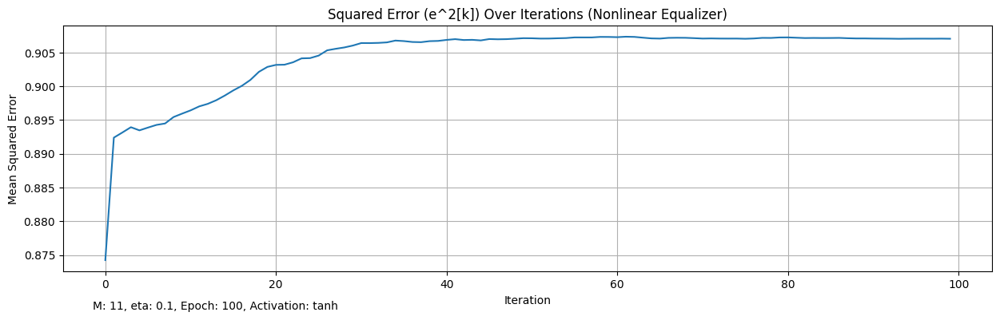

(array([-1.09602601e-01,  2.48753388e+01, -1.24197269e+02,  2.77230422e+02,
        -1.27632866e+03, -1.57687771e+04,  6.87271972e+04,  3.15023599e+05,
         5.66577675e+04, -1.56882815e+04, -2.27424577e+03]),
 array([ 1,  1,  1,  1,  1,  1,  1, -1,  1, -1, -1,  1,  1,  1,  1, -1, -1,
         1, -1,  1,  1,  1,  1,  1,  1,  1, -1, -1, -1,  1]))

In [50]:
# Parameters for the nonlinear adaptive equalizer
M = 11
eta = 0.1
max_iter = 100
delay = -7
activation = 'tanh'  # Choose 'tanh', 'relu', or 'leaky_relu'

# Run the nonlinear adaptive equalizer
weights, e2, equalized_output = nonlinear_adaptive_equalizer(y, x, M, eta, max_iter, delay, activation, init_method='zeros')

# Align equalized output by shifting for the delay
equalized_output_shifted = np.roll(equalized_output, -abs(delay))

# Plot the squared error over iterations
plt.figure(figsize=(15, 4))
plt.plot(e2)
plt.title("Squared Error (e^2[k]) Over Iterations (Nonlinear Equalizer)")
plt.figtext(0.15, -0.01, f"M: {M}, eta: {eta}, Epoch: {epoch+1}, Activation: {activation}", fontsize=10)
plt.xlabel("Iteration")
plt.ylabel("Mean Squared Error")
plt.grid()
plt.show()
# Add hyperparameters to the figure legend
# Quantize the equalized output to match original symbols (+1 or -1)
equalized_output_quantized = np.where(equalized_output_shifted >= 0, 1, -1)

# Return final weights and first few quantized outputs
weights, equalized_output_quantized[:30]

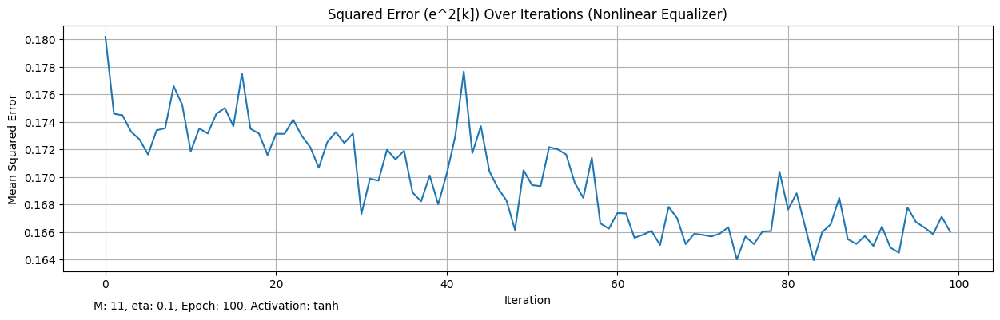

(array([ -1.29607979,  -1.95478676,   0.91339059,  -9.13381091,
          6.35381681, -18.55143411,  -8.1474819 ,  63.72874201,
        -11.99624769,  -7.98629833,  -0.6131713 ]),
 array([ 1, -1, -1,  1, -1,  1,  1, -1,  1, -1, -1, -1,  1, -1,  1, -1,  1,
        -1,  1,  1, -1,  1, -1,  1, -1,  1,  1, -1, -1,  1]))

In [28]:
# Plot the squared error over iterations
plt.figure(figsize=(15, 4))
plt.plot(e2)
plt.title("Squared Error (e^2[k]) Over Iterations (Nonlinear Equalizer)")
plt.figtext(0.15, -0.01, f"M: {M}, eta: {eta}, Epoch: {epoch+1}, Activation: {activation}", fontsize=10)
plt.xlabel("Iteration")
plt.ylabel("Mean Squared Error")
plt.grid()
plt.show()
# Add hyperparameters to the figure legend
# Quantize the equalized output to match original symbols (+1 or -1)
equalized_output_quantized = np.where(equalized_output_shifted >= 0, 1, -1)

# Return final weights and first few quantized outputs
weights, equalized_output_quantized[:30]

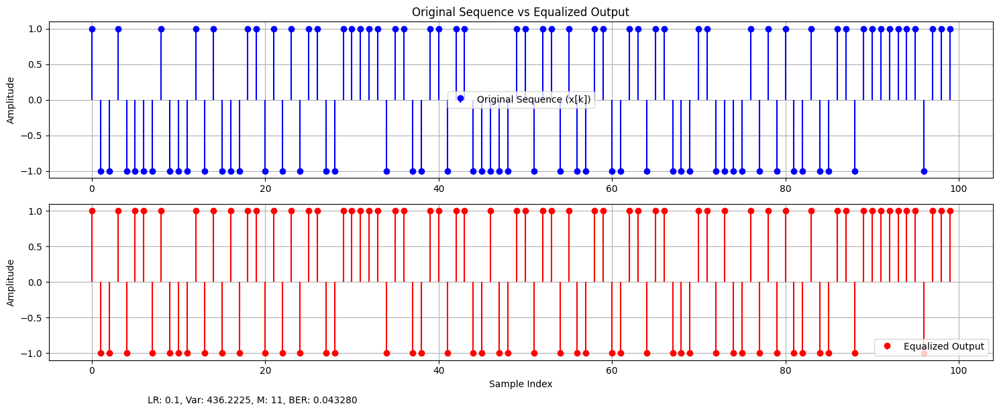

Bit Error Rate (BER): 0.043280


In [29]:
import numpy as np
import matplotlib.pyplot as plt

# Quantize the equalized output to match original symbols (+1 or -1)
equalized_output_quantized = np.where(equalized_output_shifted >= 0, 1, -1)

# Calculate Bit Error Rate (BER)
bit_errors = np.sum(equalized_output_quantized != x[:len(equalized_output_quantized)])
total_bits = len(equalized_output_quantized)
ber = bit_errors / total_bits

# Plot original sequence and equalized output using stem
plt.figure(figsize=(15, 6))

# Original sequence
plt.subplot(2, 1, 1)
plt.stem(x[:100], basefmt=" ", markerfmt="bo", linefmt="b-", label="Original Sequence (x[k])")
plt.title("Original Sequence vs Equalized Output")
plt.ylabel("Amplitude")
plt.grid()
plt.legend()

# Equalized output
plt.subplot(2, 1, 2)
plt.stem(equalized_output_quantized[:100], basefmt=" ", markerfmt="ro", linefmt="r-", label="Equalized Output")
plt.ylabel("Amplitude")
plt.xlabel("Sample Index")
plt.grid()
plt.legend()

# Add hyperparameters to the figure legend
plt.figtext(0.15, -0.01, f"LR: {eta}, Var: {np.var(weights):.4f}, M: {M}, BER: {ber:.6f}", fontsize=10)
plt.tight_layout()
plt.show()

# Print BER for reference
print(f"Bit Error Rate (BER): {ber:.6f}")
